In [1]:
import numpy as np
import pandas as pd
from datetime import datetime, timedelta
PLOT_DIAGRAM:bool = False

In [2]:
# Use plotly to plot close price, sma_1 and sma_2
import plotly.graph_objects as go

## Load with market data

In [3]:
local_data_dir = "data"
local_data_dir = "../../crypto_market_data/data"
test_exchange = "kraken"
test_symbol = "ETHUSD"
LOOK_BACK = 3
from_time_ms:int = int(datetime(2020,1,1).timestamp()*1000)
to_time_ms:int = int(datetime(2023,7,5).timestamp()*1000)

In [4]:
import os
os.getcwd()
from pathlib import Path
Path(local_data_dir).exists()

True

In [5]:
from crypto_feature_preprocess.domains.features_gen import SMA_Cross_Feature
from crypto_feature_preprocess.domains.indicators import calculate_simple_moving_average
from cryptomarketdata.port.db_client import   get_data_db_client, Database_Type
from cryptomarketdata.utility import resample_timeframe
from datetime import datetime, timedelta
import os
db_client = get_data_db_client(
        exchange=test_exchange, database_type=Database_Type.PARQUET, data_directory=local_data_dir
    )

2023-07-05 20:16:41,356 [INFO] Data stored in ../../crypto_market_data/data (db_client.py:35)
2023-07-05 20:16:41,356 [INFO] Use Parquet data set (db_client.py:41)
2023-07-05 20:16:41,357 [INFO] Using local file system (parquet_database.py:55)
2023-07-05 20:16:41,357 [INFO] Using local file system (parquet_database.py:55)


In [6]:
candles = db_client.get_candles(
    symbol=test_symbol, from_time=from_time_ms, to_time=to_time_ms
)
candles = resample_timeframe(data=candles, tf="15Min")
close_price = candles["close"]

In [7]:
sma_cross = SMA_Cross_Feature(
        df_price=close_price, sma_window_1=10, sma_window_2=50, dimension=LOOK_BACK
    )

num_features, dim = sma_cross.shape

In [8]:
raw_sma_10 = calculate_simple_moving_average(close_price, sma_cross.sma_window_1)
raw_sma_20 = calculate_simple_moving_average(close_price, sma_cross.sma_window_2)
sma_2 = calculate_simple_moving_average(close_price, sma_cross.sma_window_2)
sma_features = sma_cross.output_feature_array()


In [9]:
def padding_zeros_left(arr:np.ndarray, dim:int)->np.ndarray:
    """
    padding zeros to the left of the array to make the array length equal to dim
    """
    arr_len = len(arr)
    if arr_len == dim:
        return arr
    elif dim-arr_len > 0 :
        return np.pad(arr, pad_width=(dim-arr_len, 0))
    else:
        return arr

In [10]:
# populate feature for visualization
candles["sma10"] = padding_zeros_left(raw_sma_10, len(candles))
candles["sma20"] = padding_zeros_left(raw_sma_20, len(candles))
candles["cross"] = padding_zeros_left(sma_features[:,0], len(candles))
candles["cross-1"] = padding_zeros_left(sma_features[:,1], len(candles))
candles["cross-2"] = padding_zeros_left(sma_features[:,2], len(candles))

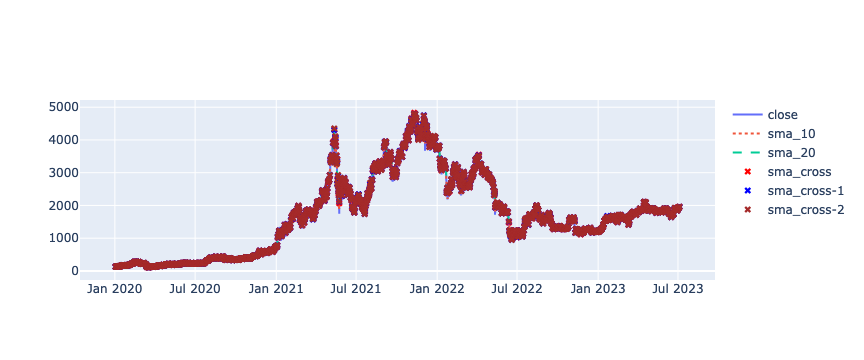

In [11]:
# With plotly, plot the close price, sma_10, sma_20 and sma_cross
# sma_10 with dotted line and sma_20 with dash line
# sma_cross with red dot for "True" value
fig = go.Figure()
fig.add_trace(go.Scatter(x=candles.index, y=candles["close"], name="close", mode="lines"))
fig.add_trace(go.Scatter(x=candles.index, y=candles["sma10"], name="sma_10", mode="lines", line_dash="dot"))
fig.add_trace(go.Scatter(x=candles.index, y=candles["sma20"], name="sma_20", mode="lines", line_dash="dash"))

#mark red x for candles["cross"] == True
cross_indices = np.where(candles["cross"] == True)[0]
fig.add_trace(go.Scatter(x=candles.index[cross_indices], y=candles["close"][cross_indices], name="sma_cross", mode="markers", marker=dict(color="red", symbol="x")))

#mark blue x for candles["cross-1"] == True
cross_indices = np.where(candles["cross-1"] == True)[0]
fig.add_trace(go.Scatter(x=candles.index[cross_indices], y=candles["close"][cross_indices], name="sma_cross-1", mode="markers", marker=dict(color="blue", symbol="x")))

#mark brown x for candles["cross-2"] == True
cross_indices = np.where(candles["cross-2"] == True)[0]
fig.add_trace(go.Scatter(x=candles.index[cross_indices], y=candles["close"][cross_indices], name="sma_cross-2", mode="markers", marker=dict(color="brown", symbol="x")))

fig.show()

In [12]:
(np.where(candles["cross"] == True))

(array([   136,    210,    307, ..., 122593, 122633, 122784]),)

In [13]:
import numpy as np

In [14]:
r1 = np.array([1,2,3,4,5])
r2 = np.array([4,5,6])
r3 = np.array([7,8,9,10])
r4 = np.array([200, 100, 300, 400])

In [15]:
#Reverse the array
r1[::-1]

array([5, 4, 3, 2, 1])

In [16]:
r1[-2:]

array([4, 5])

In [17]:
l = [r1, r2, r3, r4]

In [18]:
shortest_feature_length = min([len(f) for f in l])

In [19]:
feature_set = [f[-shortest_feature_length:].reshape(shortest_feature_length,-1) for f in l]

In [20]:
feature_set

[array([[3],
        [4],
        [5]]),
 array([[4],
        [5],
        [6]]),
 array([[ 8],
        [ 9],
        [10]]),
 array([[100],
        [300],
        [400]])]

In [21]:
np.concatenate(feature_set, axis=1)

array([[  3,   4,   8, 100],
       [  4,   5,   9, 300],
       [  5,   6,  10, 400]])

In [22]:
n = np.transpose(feature_set)

In [23]:
feature_set[0],feature_set[1]

(array([[3],
        [4],
        [5]]),
 array([[4],
        [5],
        [6]]))

do it with concatentate

In [24]:
r1 = np.arange(12).reshape(4,3)
r2 = (np.arange(20) + 100).reshape(4,5)

In [25]:
l = [r1.reshape(4,-1) , r2.reshape(4,-1)]

In [26]:
np.concatenate(l, axis=1)

array([[  0,   1,   2, 100, 101, 102, 103, 104],
       [  3,   4,   5, 105, 106, 107, 108, 109],
       [  6,   7,   8, 110, 111, 112, 113, 114],
       [  9,  10,  11, 115, 116, 117, 118, 119]])